In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler , LabelEncoder
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [2]:
data = pd.read_csv("Car Sell Dataset.csv")

In [3]:
df = data.copy()

In [4]:
df.head()

,Brand,Model Name,Model Variant,Car Type,Transmission,Fuel Type,Year,Kilometers,Owner,State,Accidental,Price
0,Mahindra,TUV300,AX5,SUV,Manual,CNG,2017,164654,1st,Rajasthan,No,547253
1,Skoda,Rapid,Style,Sedan,Manual,Petrol,2018,41351,1st,Maharashtra,No,512050
2,Maruti Suzuki,Alto,Z,Hatchback,Manual,Diesel,2002,119090,3rd+,Tamil Nadu,No,678923
3,Hyundai,Grand i10,Magna,Hatchback,Manual,Diesel,2013,19979,1st,Andhra Pradesh,No,522500
4,Mahindra,XUV500,W8,SUV,Manual,Petrol,2011,130591,3rd+,Bihar,No,401182


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 140904 entries, 0 to 140903
Data columns (total 12 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   Brand          140904 non-null  object
 1   Model Name     140904 non-null  object
 2   Model Variant  140904 non-null  object
 3   Car Type       140904 non-null  object
 4   Transmission   140904 non-null  object
 5   Fuel Type      140904 non-null  object
 6   Year           140904 non-null  int64 
 7   Kilometers     140904 non-null  int64 
 8   Owner          140904 non-null  object
 9   State          140904 non-null  object
 10  Accidental     140904 non-null  object
 11  Price          140904 non-null  int64 
dtypes: int64(3), object(9)
memory usage: 12.9+ MB


In [6]:
df.describe()

,Year,Kilometers,Price
count,140904.000000,140904.000000,1.409040e+05
mean,2016.960391,95024.595987,7.617872e+05
std,5.106106,49133.157878,4.438578e+05
min,2000.000000,10000.000000,5.005500e+04
25%,2014.000000,52421.000000,4.116420e+05
50%,2018.000000,94973.500000,6.828030e+05
75%,2021.000000,137618.000000,1.034178e+06
max,2023.000000,179998.000000,2.744280e+06


In [7]:
df.shape

(140904, 12)

In [8]:
df = df.drop(columns = ["Kilometers",	"Owner"	,"Accidental"])

In [9]:
df.head()

,Brand,Model Name,Model Variant,Car Type,Transmission,Fuel Type,Year,State,Price
0,Mahindra,TUV300,AX5,SUV,Manual,CNG,2017,Rajasthan,547253
1,Skoda,Rapid,Style,Sedan,Manual,Petrol,2018,Maharashtra,512050
2,Maruti Suzuki,Alto,Z,Hatchback,Manual,Diesel,2002,Tamil Nadu,678923
3,Hyundai,Grand i10,Magna,Hatchback,Manual,Diesel,2013,Andhra Pradesh,522500
4,Mahindra,XUV500,W8,SUV,Manual,Petrol,2011,Bihar,401182


### EDA

## Single column EDA

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\3999090898.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "viridis")


<Axes: xlabel='Brand'>

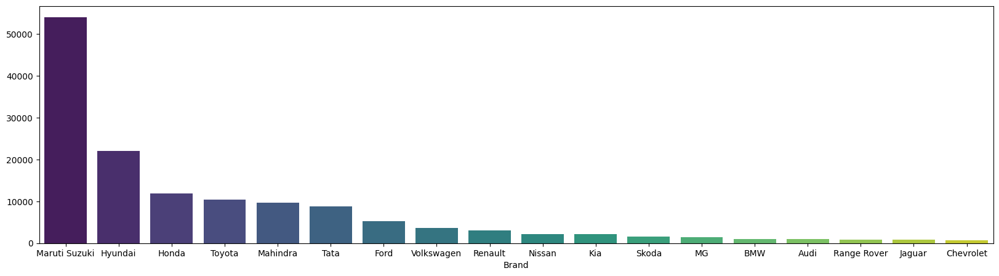

In [10]:
temp = df["Brand"].value_counts()
plt.figure(figsize = (20,5))
sns.barplot(x = temp.index , y = temp.values , palette = "viridis")

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\114940077.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "plasma")


<Axes: xlabel='Model Name'>

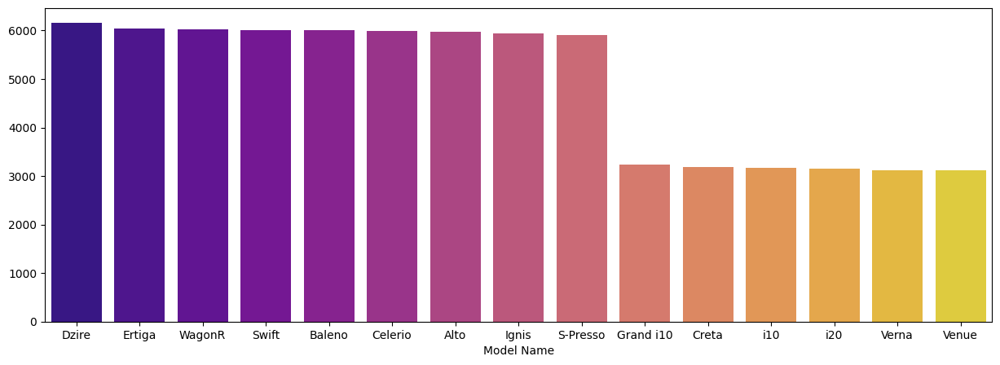

In [11]:
temp = df["Model Name"].value_counts()[:15]
plt.figure(figsize = (15,5))
sns.barplot(x = temp.index , y = temp.values , palette = "plasma")

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\691096805.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "coolwarm")


<Axes: xlabel='Model Variant'>

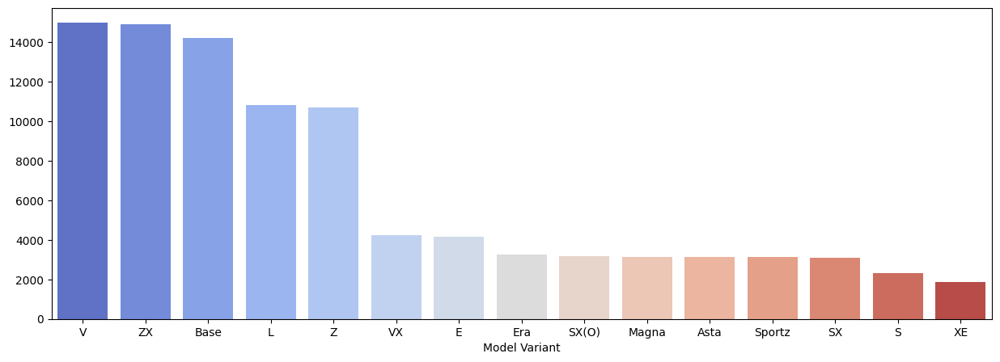

In [12]:
temp = df["Model Variant"].value_counts()[:15]
plt.figure(figsize = (15,5))
sns.barplot(x = temp.index , y = temp.values , palette = "coolwarm")

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\1951163116.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "RdBu")


<Axes: xlabel='Car Type'>

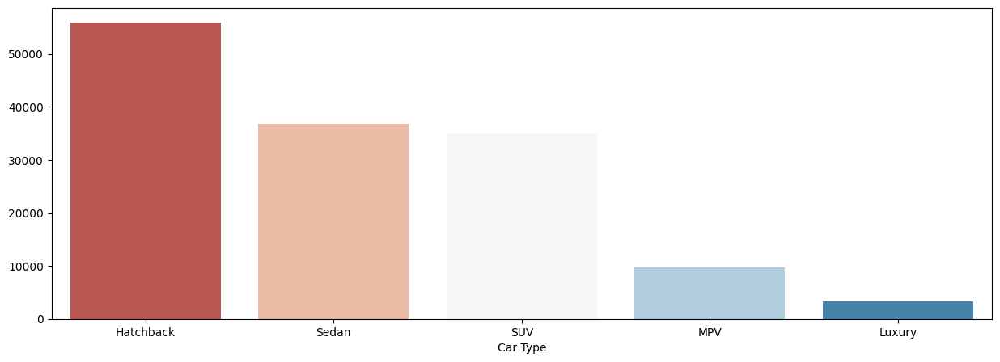

In [13]:
temp = df["Car Type"].value_counts()
plt.figure(figsize = (15,5))
sns.barplot(x = temp.index , y = temp.values , palette = "RdBu")

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\46337125.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "RdBu")


<Axes: xlabel='Transmission'>

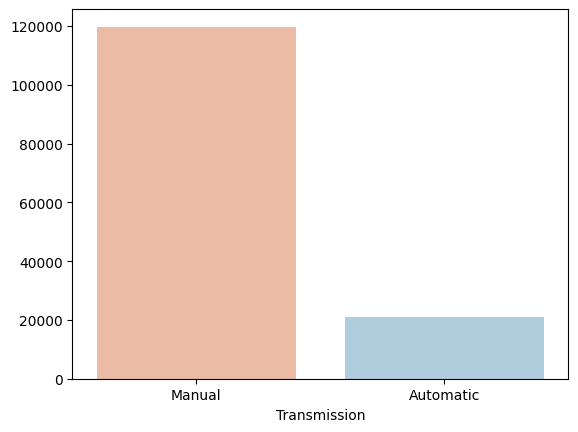

In [14]:
temp = df["Transmission"].value_counts()
sns.barplot(x = temp.index , y = temp.values , palette = "RdBu")

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\2909688679.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "Set2")


<Axes: xlabel='Fuel Type'>

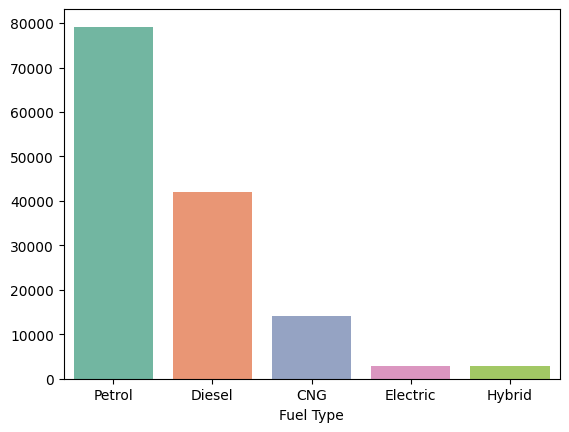

In [15]:
temp = df["Fuel Type"].value_counts()
sns.barplot(x = temp.index , y = temp.values , palette = "Set2")

In [16]:
df.head()

,Brand,Model Name,Model Variant,Car Type,Transmission,Fuel Type,Year,State,Price
0,Mahindra,TUV300,AX5,SUV,Manual,CNG,2017,Rajasthan,547253
1,Skoda,Rapid,Style,Sedan,Manual,Petrol,2018,Maharashtra,512050
2,Maruti Suzuki,Alto,Z,Hatchback,Manual,Diesel,2002,Tamil Nadu,678923
3,Hyundai,Grand i10,Magna,Hatchback,Manual,Diesel,2013,Andhra Pradesh,522500
4,Mahindra,XUV500,W8,SUV,Manual,Petrol,2011,Bihar,401182


C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\736345356.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "Set3")


<Axes: xlabel='Year'>

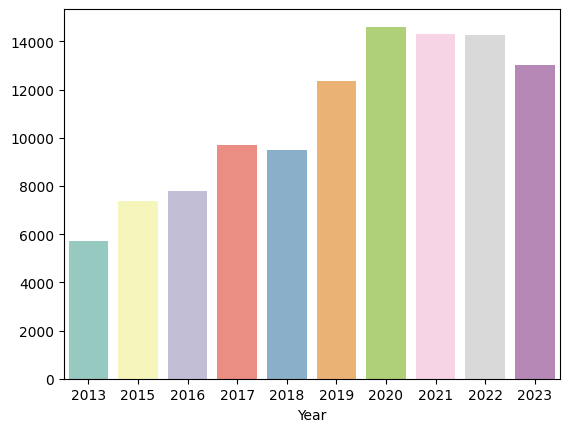

In [17]:
temp = df["Year"].value_counts()[:10]
sns.barplot(x = temp.index , y = temp.values , palette = "Set3")

<Axes: ylabel='Density'>

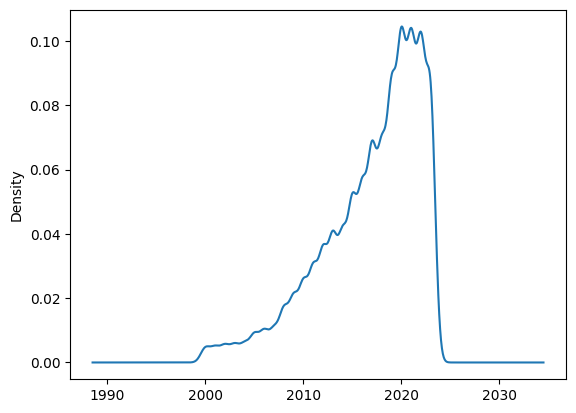

In [18]:
df["Year"].plot(kind="kde")

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\1863456224.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "Set3")


<Axes: xlabel='State'>

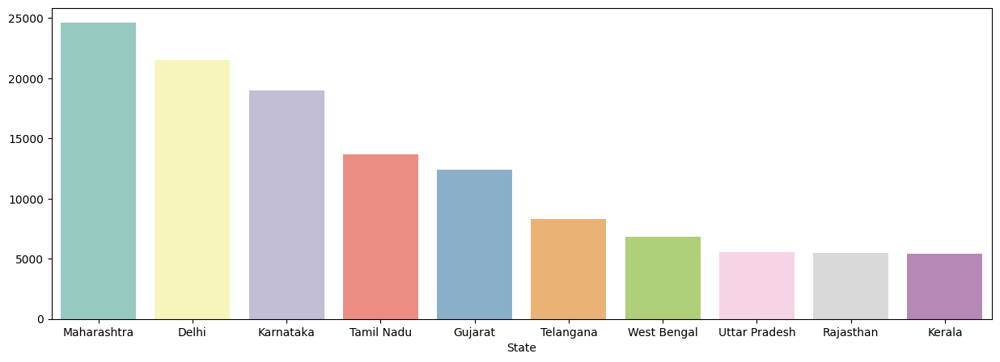

In [19]:
temp = df["State"].value_counts()[:10]
plt.figure(figsize = (15,5))
sns.barplot(x = temp.index , y = temp.values , palette = "Set3")

In [20]:
df.head()

,Brand,Model Name,Model Variant,Car Type,Transmission,Fuel Type,Year,State,Price
0,Mahindra,TUV300,AX5,SUV,Manual,CNG,2017,Rajasthan,547253
1,Skoda,Rapid,Style,Sedan,Manual,Petrol,2018,Maharashtra,512050
2,Maruti Suzuki,Alto,Z,Hatchback,Manual,Diesel,2002,Tamil Nadu,678923
3,Hyundai,Grand i10,Magna,Hatchback,Manual,Diesel,2013,Andhra Pradesh,522500
4,Mahindra,XUV500,W8,SUV,Manual,Petrol,2011,Bihar,401182


## EDA on 2 & multiple row

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\2193157722.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "Spectral")


<Axes: xlabel='Brand'>

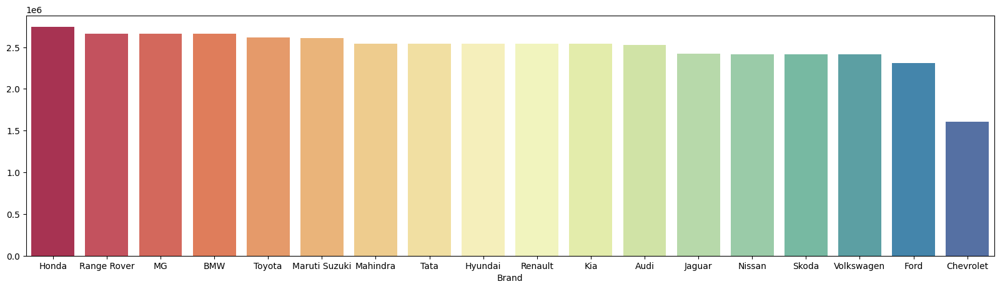

In [21]:
temp = df.groupby("Brand")["Price"].max().sort_values(ascending=False)
plt.figure(figsize = (20,5))
sns.barplot(x = temp.index , y = temp.values , palette = "Spectral")

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\3130550156.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "Spectral")


<Axes: xlabel='Car Type'>

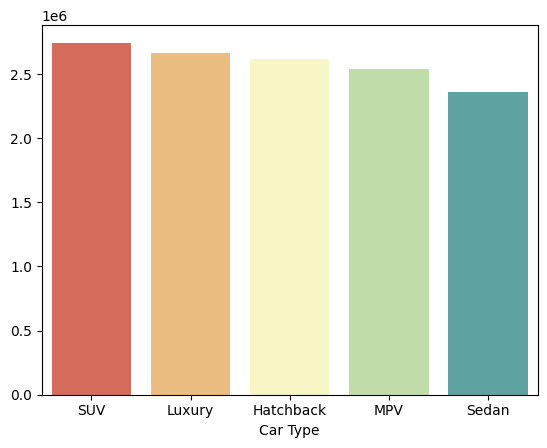

In [22]:
temp = df.groupby("Car Type")["Price"].max().sort_values(ascending=False)
sns.barplot(x = temp.index , y = temp.values , palette = "Spectral")

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\2244497678.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = temp.index , y = temp.values , palette = "Spectral")


<Axes: xlabel='Fuel Type'>

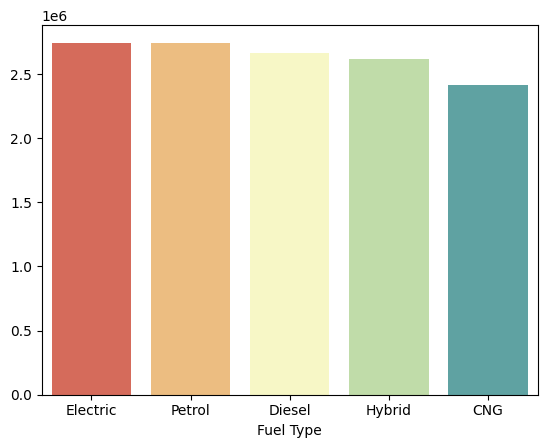

In [23]:
temp = df.groupby("Fuel Type")["Price"].max().sort_values(ascending=False)
sns.barplot(x = temp.index , y = temp.values , palette = "Spectral")

In [24]:
pd.crosstab(df["Brand"],df["Fuel Type"])

Fuel Type,CNG,Diesel,Electric,Hybrid,Petrol
Brand,,,,,
Audi,102,311,21,17,561
BMW,111,310,23,20,588
Chevrolet,80,204,15,13,440
Ford,539,1593,96,93,2896
Honda,1172,3613,265,243,6643
Hyundai,2245,6625,439,436,12345
Jaguar,81,272,23,18,490
Kia,229,620,40,34,1223
MG,137,440,24,31,860


<Axes: xlabel='Fuel Type', ylabel='Brand'>

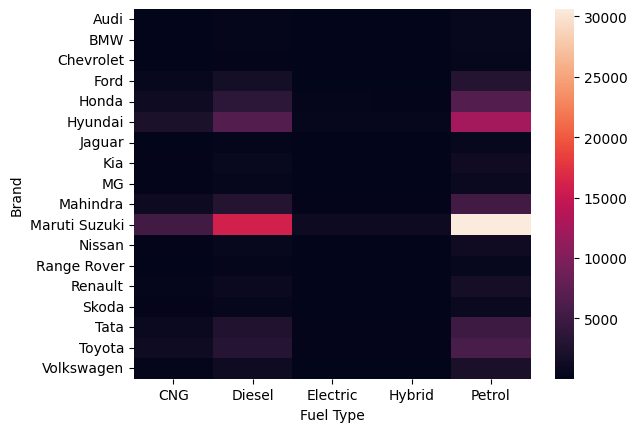

In [25]:
sns.heatmap(pd.crosstab(df["Brand"],df["Fuel Type"]))

In [26]:
df.head()

,Brand,Model Name,Model Variant,Car Type,Transmission,Fuel Type,Year,State,Price
0,Mahindra,TUV300,AX5,SUV,Manual,CNG,2017,Rajasthan,547253
1,Skoda,Rapid,Style,Sedan,Manual,Petrol,2018,Maharashtra,512050
2,Maruti Suzuki,Alto,Z,Hatchback,Manual,Diesel,2002,Tamil Nadu,678923
3,Hyundai,Grand i10,Magna,Hatchback,Manual,Diesel,2013,Andhra Pradesh,522500
4,Mahindra,XUV500,W8,SUV,Manual,Petrol,2011,Bihar,401182


In [27]:
le = LabelEncoder()
for i in df.drop(columns = ["Year" , "Price"]):
    df[i] = le.fit_transform(df[i])

In [28]:
sc = StandardScaler()
df["Year"] = sc.fit_transform(df["Year"].values.reshape(-1, 1))
df["Price"] = sc.fit_transform(df["Price"].values.reshape(-1, 1))

In [29]:
df.head()

,Brand,Model Name,Model Variant,Car Type,Transmission,Fuel Type,Year,State,Price
0,9,61,1,3,1,0,0.007757,21,-0.483342
1,14,49,54,4,1,4,0.203602,15,-0.562653
2,10,4,80,0,1,1,-2.929913,22,-0.186691
3,5,32,32,0,1,1,-0.775621,0,-0.539110
4,9,80,68,3,1,4,-1.167311,2,-0.812437


In [30]:
lst = []
for i in range(1,11):
    kmeans = KMeans(n_clusters = i)
    kmeans.fit(df)
    lst.append(kmeans.inertia_)

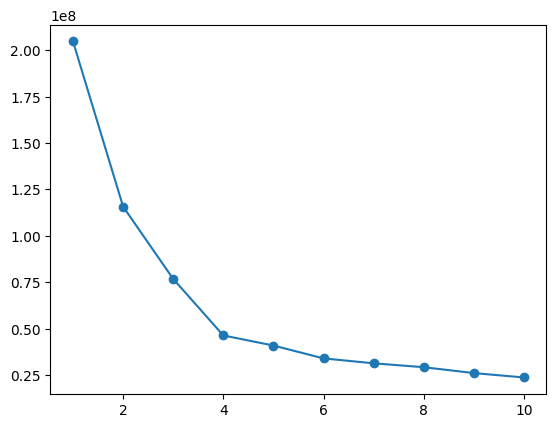

In [31]:
plt.plot(range(1,11), lst, marker='o')

In [32]:
kmeans = KMeans(n_clusters = 4)
kmeans.fit(df)

KMeans(n_clusters=4)

In [33]:
df.head()

,Brand,Model Name,Model Variant,Car Type,Transmission,Fuel Type,Year,State,Price
0,9,61,1,3,1,0,0.007757,21,-0.483342
1,14,49,54,4,1,4,0.203602,15,-0.562653
2,10,4,80,0,1,1,-2.929913,22,-0.186691
3,5,32,32,0,1,1,-0.775621,0,-0.539110
4,9,80,68,3,1,4,-1.167311,2,-0.812437


In [34]:
pca = PCA(2)
pca_encoded = pca.fit_transform(df)
centers = pca.transform(kmeans.cluster_centers_)

C:\Users\jayde\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


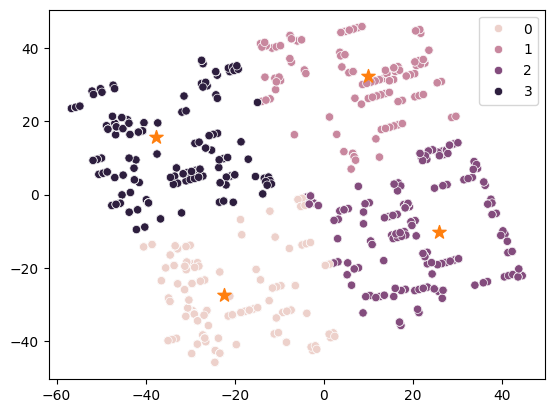

In [35]:
labels = kmeans.labels_
sns.scatterplot(x = pca_encoded[:,0] , y = pca_encoded[:,1],hue=labels)
plt.scatter(centers[:, 0], centers[:, 1], s=100, marker='*', label='Centroids')

C:\Users\jayde\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


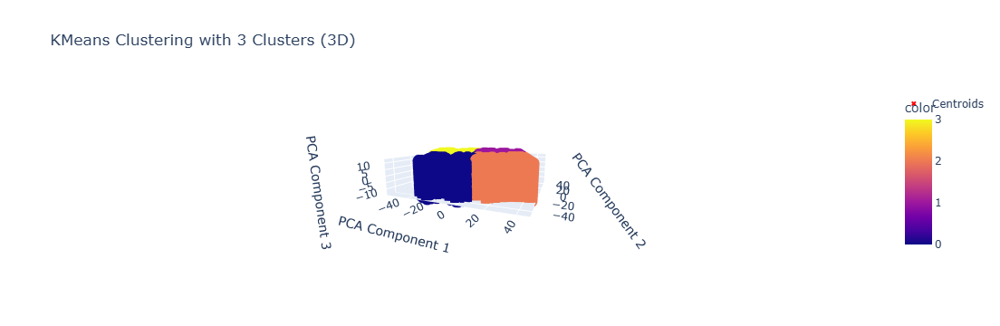

In [36]:
import plotly.express as px

pca_3d = PCA(n_components=3)
pca_df_3d = pca_3d.fit_transform(df)
centers_3d = pca_3d.transform(kmeans.cluster_centers_)

fig = px.scatter_3d(x=pca_df_3d[:, 0],y=pca_df_3d[:, 1],z=pca_df_3d[:, 2],color=labels,title="KMeans Clustering with 3 Clusters (3D)",
    labels={'x': 'PCA Component 1', 'y': 'PCA Component 2', 'z': 'PCA Component 3'})

# Add cluster centroids to the 3D plot
fig.add_scatter3d(
    x=centers_3d[:, 0],
    y=centers_3d[:, 1],
    z=centers_3d[:, 2],
    mode='markers',
    marker=dict(size=5, color='red', symbol='x'),
    name='Centroids'
)

fig.show()

In [37]:
df["clusters"] = kmeans.labels_
data_pivot = df.groupby('clusters').mean().T
data_pivot_mean = data_pivot.mean(axis=1).reset_index()
data_pivot_mean.columns = ['Variable', 'Value']

C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\2237305096.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\2237305096.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


C:\Users\jayde\AppData\Local\Temp\ipykernel_8088\2237305096.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




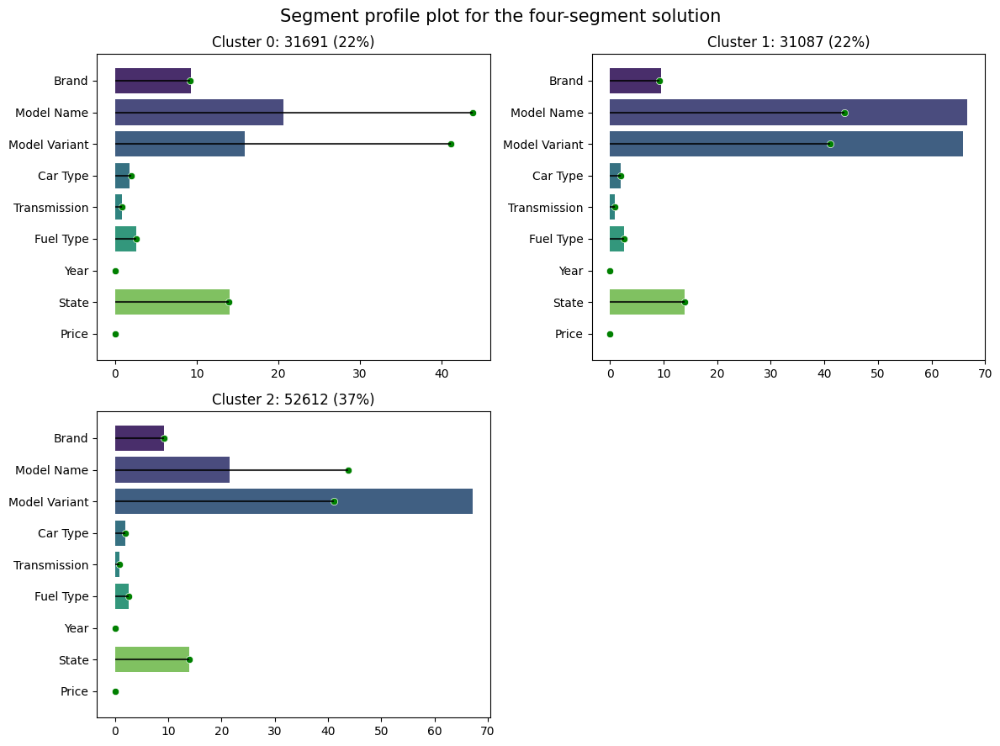

In [38]:
plt.figure(figsize = (12, 9))
for i in range(3):
    plt.subplot(2, 2, i+1)
    sns.barplot(data_pivot, x = i, y = data_pivot.index, palette='viridis')
    sns.scatterplot(data_pivot_mean, x = 'Value', y = 'Variable', color = 'green')
    for index, row in data_pivot_mean.iterrows():
        plt.hlines(y=row['Variable'], xmin=0, xmax=row['Value'], colors='black', alpha = 0.8)
    plt.ylabel("")
    plt.xlabel("")
    plt.title(f"Cluster {i}: {df['clusters'].value_counts()[i]} ({df['clusters'].value_counts()[i]*100/len(df):.0f}%)")

plt.suptitle("Segment profile plot for the four-segment solution", fontsize = 15)
plt.tight_layout()
plt.show()

### Conclusions

### Brand Distribution
- Maruti, Hyundai, Tata, and Honda dominate the Indian car market.

- These brands offer diverse price points, making them suitable for multiple income groups.

### Price Range
- Majority of cars are priced between ₹3–12 lakhs, indicating a mid-income target audience.

- Higher-priced segments (₹15L+) form a smaller portion, ideal for niche premium targeting.

### Fuel Type
- Petrol cars are the most dominant, followed by diesel.

- EVs and hybrids are still minimal in number, reflecting their early stage in adoption.

### Transmission
- Manual transmission dominates (~85% of listings), showing India’s price sensitivity and preference for control.

- Automatic is more common in recent models and premium segments.

### Year of Manufacture
- Most vehicles are less than 5 years old, showing buyer interest in recent models with updated features.



### Q1: Which Brand is Appropriate to Sell?
- Maruti and Hyundai are consistently dominant across clusters.

- Tata is ideal for safety-conscious, budget buyers (Cluster 1).

- Kia and Honda appeal to feature-focused and younger audiences (Cluster 0 and 2).

### Cluster 0 – 39% of Data

- High focus on Model Name and Model Variant
- Very low importance to Brand and Price
- Slight presence across States


### Cluster 1 – 37% of Data

- High focus on Model Variant
- Moderate interest in Model Name
- Low sensitivity to Brand and Fuel Type


### Cluster 2 – 24% of Data

- High values for Model Variant and Model Name
- Moderate attention to Transmission, Year, and State-
- Slight influence of Price
